## به دست آوردن تقاضای سفر ( دسته بندی کردن ماشین ها با توجه به شباهت حرکت)

## دسته بندی ماشین ها با K_Means

In [2]:
import pandas as pd
from sklearn.cluster import KMeans

# خواندن دیتاست
df = pd.read_csv('Data_p1.csv')

# انتخاب ستون‌های مورد نیاز برای دسته‌بندی
selected_columns = ['DEVICEID', 'PASSDATETIME']

# ایجاد یک دیتافریم جدید با ستون‌های انتخاب شده
df_selected = df[selected_columns]

# استفاده از الگوریتم K-Means برای دسته‌بندی
kmeans = KMeans(n_clusters=4)  # تعداد دسته‌ها را می‌توان تغییر داد
kmeans.fit(df_selected)

# افزودن ستون دسته به دیتافریم اصلی
df['CLUSTER'] = kmeans.labels_

# نمایش دسته‌بندی شده
grouped = df.groupby('CLUSTER')
for group, data in grouped:
    print(f"Cluster {group}")
    print(data[selected_columns])
    print()


FileNotFoundError: [Errno 2] No such file or directory: 'Data_p1.csv'

D:\ANACONDA\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


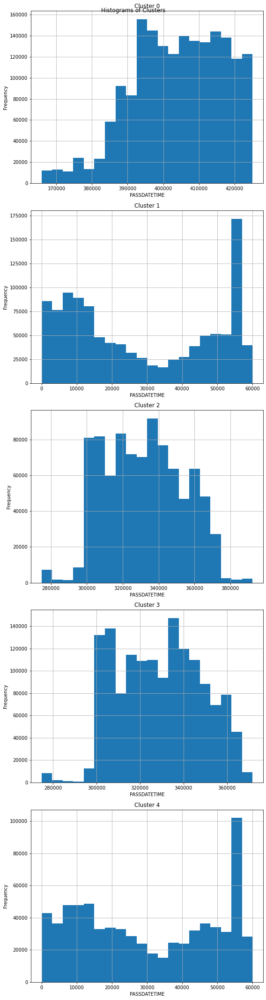

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# خواندن دیتاست
df = pd.read_csv('Data_p1.csv')

# انتخاب ستون‌های مورد نیاز برای دسته‌بندی
selected_columns = ['DEVICEID', 'PASSDATETIME']

# ایجاد یک دیتافریم جدید با ستون‌های انتخاب شده
df_selected = df[selected_columns]

# استفاده از الگوریتم K-Means برای دسته‌بندی
kmeans = KMeans(n_clusters=5)  # تعداد دسته‌ها را می‌توان تغییر داد
kmeans.fit(df_selected)

# افزودن ستون دسته به دیتافریم اصلی
df['CLUSTER'] = kmeans.labels_

# تعداد دسته‌ها
num_clusters = len(set(kmeans.labels_))

# نمایش نمودارهای histogram براساس دسته‌ها
fig, axs = plt.subplots(num_clusters, 1, figsize=(8, 6*num_clusters))
fig.suptitle('Histograms of Clusters')

for cluster in range(num_clusters):
    cluster_data = df[df['CLUSTER'] == cluster]
    cluster_data['PASSDATETIME'].hist(ax=axs[cluster], bins=20)
    axs[cluster].set_title(f'Cluster {cluster}')
    axs[cluster].set_xlabel('PASSDATETIME')
    axs[cluster].set_ylabel('Frequency')

plt.tight_layout()
plt.show()


## نمایش خوشه ها در نمودار

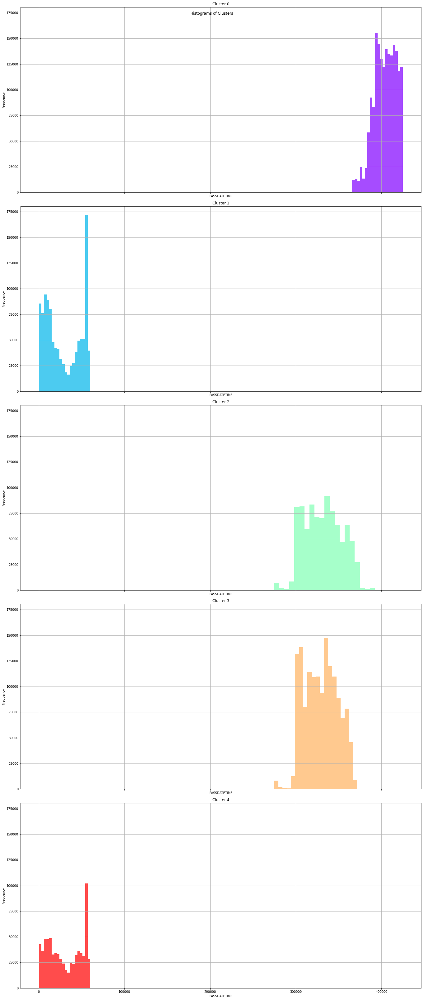

In [3]:
import numpy as np

# تعیین رنگ‌ها برای دسته‌ها
colors = plt.cm.rainbow(np.linspace(0, 1, num_clusters))

# نمایش نمودارهای histogram براساس دسته‌ها با رنگ‌های مختلف و اضافه کردن قابلیت مقایسه
fig, axs = plt.subplots(num_clusters, 1, figsize=(19,9*num_clusters), sharex=True, sharey=True)
fig.suptitle('Histograms of Clusters')

for cluster in range(num_clusters):
    cluster_data = df[df['CLUSTER'] == cluster]
    cluster_data['PASSDATETIME'].hist(ax=axs[cluster], bins=20, color=colors[cluster], alpha=0.7)
    axs[cluster].set_title(f'Cluster {cluster}')
    axs[cluster].set_xlabel('PASSDATETIME')
    axs[cluster].set_ylabel('Frequency')

plt.tight_layout()
plt.show()


# نمایش دسته بندی ها به ترتیب و در جدول

In [10]:
import pandas as pd
from sklearn.cluster import KMeans

# خواندن داده‌ها
df = pd.read_csv('Data_p1.csv')

# انتخاب ویژگی‌ها برای دسته‌بندی
features = ['DEVICEID', 'vehicleId', 'PASSDATETIME']

# استخراج ویژگی‌ها
X = df[features]

# تعداد خوشه‌ها
num_clusters = 4  # تعداد خوشه‌ها   

# اجرای الگوریتم K-Means
kmeans = KMeans(n_clusters=num_clusters)
kmeans.fit(X)

# برچسب‌های خوشه‌ها
labels = kmeans.labels_

# افزودن برچسب‌ها به داده‌ها
df['Cluster'] = labels

# نمایش دسته‌بندی خوشه‌ها در جدول
cluster_df = pd.DataFrame({'DEVICEID': df['DEVICEID'], 'vehicleId': df['vehicleId'], 'PASSDATETIME': df['PASSDATETIME'], 'Cluster': df['Cluster']})
sorted_cluster_df = cluster_df.sort_values(by='Cluster')

print(sorted_cluster_df)


D:\ANACONDA\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


         DEVICEID    vehicleId  PASSDATETIME  Cluster
1755653     73302  32464849350        309016        0
1246344     42110  33009988470        387013        0
4146624     37385  18911551154          8413        0
5114728     79168  25293394863        335235        0
1246338     41956  28119325870        387021        0
...           ...          ...           ...      ...
2078217     73722  37432324717        407125        3
4527113     93966  57974121247         54190        3
4527111     93266  37885028820         54194        3
2078193     43139  40100707960        413300        3
0          101610  40321227460        307695        3

[6000000 rows x 4 columns]


In [1]:
import pandas as pd
from sklearn.cluster import KMeans

# خواندن داده‌ها
df = pd.read_csv('Data_p1.csv')

# انتخاب ویژگی‌ها برای دسته‌بندی
features = ['DEVICEID', 'vehicleId', 'PASSDATETIME']

# استخراج ویژگی‌ها
X = df[features]

# تعداد خوشه‌ها
num_clusters = 4  # تعداد خوشه‌ها   

# اجرای الگوریتم K-Means
kmeans = KMeans(n_clusters=num_clusters)
kmeans.fit(X)

# برچسب‌های خوشه‌ها
labels = kmeans.labels_

# افزودن برچسب‌ها به داده‌ها
df['Cluster'] = labels

# نمایش دسته‌بندی خوشه‌ها در جدول با رنگ‌های مختلف
cluster_df = pd.DataFrame({'DEVICEID': df['DEVICEID'], 'vehicleId': df['vehicleId'], 'PASSDATETIME': df['PASSDATETIME'], 'Cluster': df['Cluster']})

# تابع تغییر رنگ بر اساس مقادیر
def color_map(val):
    colors = ['#FFC300', '#FF5733', '#C70039', '#900C3F', '#581845']
    return 'background-color: {}'.format(colors[val])

styled_cluster_df = cluster_df.style.applymap(color_map, subset=['Cluster'])

# نمایش جدول با رنگ‌های مختلف برای خوشه‌ها
styled_cluster_df


D:\ANACONDA\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [4]:
df = pd.read_csv('Data_p1.csv')

total_demand = df.shape[0]
print("تقاضای کل سفر: ", total_demand)


FileNotFoundError: [Errno 2] No such file or directory: 'Data_p1.csv'

In [ ]:
camera_demand = df.groupby('DEVICEID').size().reset_index(name='TrafficCount')
print(camera_demand)
